In [1]:
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

In [2]:
df = pd.read_csv(r'C:/Users/Ali/Downloads/Automobile.csv')


In [11]:
import pandas_profiling as pp
pp.ProfileReport(auto)

In [12]:
auto.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 205 entries, 0 to 204
Data columns (total 26 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   symboling          205 non-null    int64  
 1   normalized-losses  205 non-null    object 
 2   make               205 non-null    object 
 3   fuel-type          205 non-null    object 
 4   aspiration         205 non-null    object 
 5   num-of-doors       205 non-null    object 
 6   body-style         205 non-null    object 
 7   drive-wheels       205 non-null    object 
 8   engine-location    205 non-null    object 
 9   wheel-base         205 non-null    float64
 10  length             205 non-null    float64
 11  width              205 non-null    float64
 12  height             205 non-null    float64
 13  curb-weight        205 non-null    int64  
 14  engine-type        205 non-null    object 
 15  num-of-cylinders   205 non-null    object 
 16  engine-size        205 non

In [18]:
auto['make'].value_counts()

toyota           32
nissan           18
mazda            17
mitsubishi       13
honda            13
subaru           12
volkswagen       12
peugot           11
volvo            11
dodge             9
mercedes-benz     8
bmw               8
plymouth          7
audi              7
saab              6
porsche           5
isuzu             4
jaguar            3
alfa-romero       3
chevrolet         3
renault           2
mercury           1
Name: make, dtype: int64

# Cleaning First

In [6]:
df

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,...,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
0,3,?,alfa-romero,gas,std,two,convertible,rwd,front,88.6,...,130,mpfi,3.47,2.68,9.0,111,5000,21,27,13495
1,3,?,alfa-romero,gas,std,two,convertible,rwd,front,88.6,...,130,mpfi,3.47,2.68,9.0,111,5000,21,27,16500
2,1,?,alfa-romero,gas,std,two,hatchback,rwd,front,94.5,...,152,mpfi,2.68,3.47,9.0,154,5000,19,26,16500
3,2,164,audi,gas,std,four,sedan,fwd,front,99.8,...,109,mpfi,3.19,3.40,10.0,102,5500,24,30,13950
4,2,164,audi,gas,std,four,sedan,4wd,front,99.4,...,136,mpfi,3.19,3.40,8.0,115,5500,18,22,17450
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
200,-1,95,volvo,gas,std,four,sedan,rwd,front,109.1,...,141,mpfi,3.78,3.15,9.5,114,5400,23,28,16845
201,-1,95,volvo,gas,turbo,four,sedan,rwd,front,109.1,...,141,mpfi,3.78,3.15,8.7,160,5300,19,25,19045
202,-1,95,volvo,gas,std,four,sedan,rwd,front,109.1,...,173,mpfi,3.58,2.87,8.8,134,5500,18,23,21485
203,-1,95,volvo,diesel,turbo,four,sedan,rwd,front,109.1,...,145,idi,3.01,3.40,23.0,106,4800,26,27,22470


### Cleaning Price

In [3]:
df.price.replace('?',0, inplace=True)

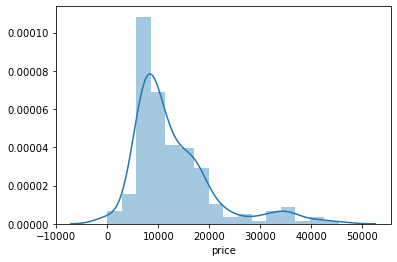

In [4]:
sns.distplot(df.price)

In [5]:
df[df.price == 0]

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,...,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
9,0,?,audi,gas,turbo,two,hatchback,4wd,front,99.5,...,131,mpfi,3.13,3.40,7.0,160,5500,16,22,0
44,1,?,isuzu,gas,std,two,sedan,fwd,front,94.5,...,90,2bbl,3.03,3.11,9.6,70,5400,38,43,0
45,0,?,isuzu,gas,std,four,sedan,fwd,front,94.5,...,90,2bbl,3.03,3.11,9.6,70,5400,38,43,0
129,1,?,porsche,gas,std,two,hatchback,rwd,front,98.4,...,203,mpfi,3.94,3.11,10.0,288,5750,17,28,0


In [6]:
df['price'] = pd.to_numeric(df['price'])

In [7]:
df[df['body-style'] == 'hatchback'].price.mean()

9672.942857142858

In [8]:
df[df['body-style'] == 'sedan'].price.mean()

14158.510416666666

In [9]:
#df.loc[(df['body-style'] == 'hatchback') & (df['price'] == 0)].price = 34432
#df.loc[(df['body-style'] == 'sedan') & (df['price'] == 0)].price.replace(0, 14158)


In [10]:
#df.loc[(df['body-style'] == 'sedan')& (df['price'] == 0), 'price'].replace(0,14158, inplace= True)

In [11]:
df.loc[(df['body-style'] == 'sedan') & (df['price'] == 0), 'price'] = 14158 
df.loc[(df['body-style'] == 'hatchback') & (df['price'] == 0), 'price'] = 9672 

In [12]:
 
df[df['body-style'] == 'hatchback']

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,...,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
2,1,?,alfa-romero,gas,std,two,hatchback,rwd,front,94.5,...,152,mpfi,2.68,3.47,9.00,154,5000,19,26,16500
9,0,?,audi,gas,turbo,two,hatchback,4wd,front,99.5,...,131,mpfi,3.13,3.40,7.00,160,5500,16,22,9672
18,2,121,chevrolet,gas,std,two,hatchback,fwd,front,88.4,...,61,2bbl,2.91,3.03,9.50,48,5100,47,53,5151
19,1,98,chevrolet,gas,std,two,hatchback,fwd,front,94.5,...,90,2bbl,3.03,3.11,9.60,70,5400,38,43,6295
21,1,118,dodge,gas,std,two,hatchback,fwd,front,93.7,...,90,2bbl,2.97,3.23,9.41,68,5500,37,41,5572
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175,-1,65,toyota,gas,std,four,hatchback,fwd,front,102.4,...,122,mpfi,3.31,3.54,8.70,92,4200,27,32,9988
177,-1,65,toyota,gas,std,four,hatchback,fwd,front,102.4,...,122,mpfi,3.31,3.54,8.70,92,4200,27,32,11248
178,3,197,toyota,gas,std,two,hatchback,rwd,front,102.9,...,171,mpfi,3.27,3.35,9.30,161,5200,20,24,16558
179,3,197,toyota,gas,std,two,hatchback,rwd,front,102.9,...,171,mpfi,3.27,3.35,9.30,161,5200,19,24,15998


In [13]:
df.loc[(df['body-style'] == 'hatchback') & (df['price'] == 0)] 

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,...,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price


In [14]:
df.price.unique()

array([13495, 16500, 13950, 17450, 15250, 17710, 18920, 23875,  9672,
       16430, 16925, 20970, 21105, 24565, 30760, 41315, 36880,  5151,
        6295,  6575,  5572,  6377,  7957,  6229,  6692,  7609,  8558,
        8921, 12964,  6479,  6855,  5399,  6529,  7129,  7295,  7895,
        9095,  8845, 10295, 12945, 10345,  6785, 14158, 11048, 32250,
       35550, 36000,  5195,  6095,  6795,  6695,  7395, 10945, 11845,
       13645, 15645,  8495, 10595, 10245, 10795, 11245, 18280, 18344,
       25552, 28248, 28176, 31600, 34184, 35056, 40960, 45400, 16503,
        5389,  6189,  6669,  7689,  9959,  8499, 12629, 14869, 14489,
        6989,  8189,  9279,  5499,  7099,  6649,  6849,  7349,  7299,
        7799,  7499,  7999,  8249,  8949,  9549, 13499, 14399, 17199,
       19699, 18399, 11900, 13200, 12440, 13860, 15580, 16900, 16695,
       17075, 16630, 17950, 18150, 12764, 22018, 32528, 34028, 37028,
        9295,  9895, 11850, 12170, 15040, 15510, 18620,  5118,  7053,
        7603,  7126,

### Cleaning Doors and Normalized loses

In [15]:
df[df['num-of-doors'] == '?']

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,...,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
27,1,148,dodge,gas,turbo,?,sedan,fwd,front,93.7,...,98,mpfi,3.03,3.39,7.6,102,5500,24,30,8558
63,0,?,mazda,diesel,std,?,sedan,fwd,front,98.8,...,122,idi,3.39,3.39,22.7,64,4650,36,42,10795


In [16]:
df['num-of-doors'].value_counts()

four    114
two      89
?         2
Name: num-of-doors, dtype: int64

In [17]:
df.loc[(df['num-of-doors'] == '?') , 'num-of-doors' ] = 'four' 

In [18]:
df[df['num-of-doors'] == '?']

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,...,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price


In [19]:
df['normalized-losses'].replace('?',0, inplace=True)


In [20]:
df['normalized-losses'] = pd.to_numeric(df['normalized-losses'])
df['normalized-losses'].unique()

array([  0, 164, 158, 192, 188, 121,  98,  81, 118, 148, 110, 145, 137,
       101,  78, 106,  85, 107, 104, 113, 150, 129, 115,  93, 142, 161,
       153, 125, 128, 122, 103, 168, 108, 194, 231, 119, 154,  74, 186,
        83, 102,  89,  87,  77,  91, 134,  65, 197,  90,  94, 256,  95],
      dtype=int64)

In [21]:
pd.pivot_table(data=df , index='body-style', values='normalized-losses', aggfunc= np.mean )

,normalized-losses
body-style,
convertible,46.000000
hardtop,82.875000
hatchback,113.214286
sedan,100.583333
wagon,59.520000


In [22]:
df.loc[(df['body-style'] == 'hatchback') & (df['normalized-losses'] == 0), 'normalized-losses'] = 113

In [23]:
df.loc[(df['body-style'] == 'convertible') & (df['normalized-losses'] == 0), 'normalized-losses'] = 46
df.loc[(df['body-style'] == 'sedan') & (df['normalized-losses'] == 0), 'normalized-losses'] = 100
df.loc[(df['body-style'] == 'wagon') & (df['normalized-losses'] == 0), 'normalized-losses'] = 59
df.loc[(df['body-style'] == 'hardtop') & (df['normalized-losses'] == 0), 'normalized-losses'] = 82

In [24]:
df['normalized-losses'].value_counts()

100    16
113    12
161    11
59      8
91      8
150     7
128     6
134     6
104     6
102     5
94      5
168     5
103     5
95      5
74      5
85      5
65      5
93      4
148     4
46      4
122     4
106     4
118     4
101     3
115     3
82      3
125     3
154     3
83      3
137     3
89      2
87      2
110     2
108     2
197     2
81      2
129     2
145     2
153     2
158     2
164     2
188     2
192     2
194     2
119     2
77      1
78      1
231     1
90      1
98      1
107     1
121     1
142     1
186     1
256     1
Name: normalized-losses, dtype: int64

In [25]:
df.describe()

,symboling,normalized-losses,wheel-base,length,width,height,curb-weight,engine-size,compression-ratio,city-mpg,highway-mpg,price
count,205.000000,205.000000,205.000000,205.000000,205.000000,205.000000,205.000000,205.000000,205.000000,205.000000,205.000000,205.000000
mean,0.834146,115.317073,98.756585,174.049268,65.907805,53.724878,2555.565854,126.907317,10.142537,25.219512,30.751220,13181.917073
std,1.245307,35.960653,6.021776,12.337289,2.145204,2.443522,520.680204,41.642693,3.972040,6.542142,6.886443,7877.071768
min,-2.000000,46.000000,86.600000,141.100000,60.300000,47.800000,1488.000000,61.000000,7.000000,13.000000,16.000000,5118.000000
25%,0.000000,93.000000,94.500000,166.300000,64.100000,52.000000,2145.000000,97.000000,8.600000,19.000000,25.000000,7788.000000
50%,1.000000,106.000000,97.000000,173.200000,65.500000,54.100000,2414.000000,120.000000,9.000000,24.000000,30.000000,10295.000000
75%,2.000000,137.000000,102.400000,183.100000,66.900000,55.500000,2935.000000,141.000000,9.400000,30.000000,34.000000,16500.000000
max,3.000000,256.000000,120.900000,208.100000,72.300000,59.800000,4066.000000,326.000000,23.000000,49.000000,54.000000,45400.000000


In [26]:
df

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,...,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
0,3,46,alfa-romero,gas,std,two,convertible,rwd,front,88.6,...,130,mpfi,3.47,2.68,9.0,111,5000,21,27,13495
1,3,46,alfa-romero,gas,std,two,convertible,rwd,front,88.6,...,130,mpfi,3.47,2.68,9.0,111,5000,21,27,16500
2,1,113,alfa-romero,gas,std,two,hatchback,rwd,front,94.5,...,152,mpfi,2.68,3.47,9.0,154,5000,19,26,16500
3,2,164,audi,gas,std,four,sedan,fwd,front,99.8,...,109,mpfi,3.19,3.40,10.0,102,5500,24,30,13950
4,2,164,audi,gas,std,four,sedan,4wd,front,99.4,...,136,mpfi,3.19,3.40,8.0,115,5500,18,22,17450
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
200,-1,95,volvo,gas,std,four,sedan,rwd,front,109.1,...,141,mpfi,3.78,3.15,9.5,114,5400,23,28,16845
201,-1,95,volvo,gas,turbo,four,sedan,rwd,front,109.1,...,141,mpfi,3.78,3.15,8.7,160,5300,19,25,19045
202,-1,95,volvo,gas,std,four,sedan,rwd,front,109.1,...,173,mpfi,3.58,2.87,8.8,134,5500,18,23,21485
203,-1,95,volvo,diesel,turbo,four,sedan,rwd,front,109.1,...,145,idi,3.01,3.40,23.0,106,4800,26,27,22470


### Cleaning stroke and bore

In [27]:
df[(df['bore'] == '?')]

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,...,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
55,3,150,mazda,gas,std,two,hatchback,rwd,front,95.3,...,70,4bbl,?,?,9.4,101,6000,17,23,10945
56,3,150,mazda,gas,std,two,hatchback,rwd,front,95.3,...,70,4bbl,?,?,9.4,101,6000,17,23,11845
57,3,150,mazda,gas,std,two,hatchback,rwd,front,95.3,...,70,4bbl,?,?,9.4,101,6000,17,23,13645
58,3,150,mazda,gas,std,two,hatchback,rwd,front,95.3,...,80,mpfi,?,?,9.4,135,6000,16,23,15645


In [28]:
df['bore'].replace('?',0, inplace=True)
df['stroke'].replace('?',0, inplace=True)
df['stroke'] = pd.to_numeric(df['stroke'])
df['bore'] = pd.to_numeric(df['bore'])


In [29]:
df.loc[(df['bore'] == 0), 'bore' ] = 3.21

In [30]:
df[(df['make'] == 'mazda') & (df['body-style'] == 'hatchback')]

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,...,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
50,1,104,mazda,gas,std,two,hatchback,fwd,front,93.1,...,91,2bbl,3.03,3.15,9.0,68,5000,30,31,5195
51,1,104,mazda,gas,std,two,hatchback,fwd,front,93.1,...,91,2bbl,3.03,3.15,9.0,68,5000,31,38,6095
52,1,104,mazda,gas,std,two,hatchback,fwd,front,93.1,...,91,2bbl,3.03,3.15,9.0,68,5000,31,38,6795
55,3,150,mazda,gas,std,two,hatchback,rwd,front,95.3,...,70,4bbl,3.21,0.00,9.4,101,6000,17,23,10945
56,3,150,mazda,gas,std,two,hatchback,rwd,front,95.3,...,70,4bbl,3.21,0.00,9.4,101,6000,17,23,11845
57,3,150,mazda,gas,std,two,hatchback,rwd,front,95.3,...,70,4bbl,3.21,0.00,9.4,101,6000,17,23,13645
58,3,150,mazda,gas,std,two,hatchback,rwd,front,95.3,...,80,mpfi,3.21,0.00,9.4,135,6000,16,23,15645
59,1,129,mazda,gas,std,two,hatchback,fwd,front,98.8,...,122,2bbl,3.39,3.39,8.6,84,4800,26,32,8845
61,1,129,mazda,gas,std,two,hatchback,fwd,front,98.8,...,122,2bbl,3.39,3.39,8.6,84,4800,26,32,10595
64,0,115,mazda,gas,std,four,hatchback,fwd,front,98.8,...,122,2bbl,3.39,3.39,8.6,84,4800,26,32,11245


In [31]:
df.loc[(df['stroke'] == 0), 'stroke' ] = 3.27

In [32]:
df[(df['make'] == 'mazda') & (df['body-style'] == 'hatchback')]

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,...,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
50,1,104,mazda,gas,std,two,hatchback,fwd,front,93.1,...,91,2bbl,3.03,3.15,9.0,68,5000,30,31,5195
51,1,104,mazda,gas,std,two,hatchback,fwd,front,93.1,...,91,2bbl,3.03,3.15,9.0,68,5000,31,38,6095
52,1,104,mazda,gas,std,two,hatchback,fwd,front,93.1,...,91,2bbl,3.03,3.15,9.0,68,5000,31,38,6795
55,3,150,mazda,gas,std,two,hatchback,rwd,front,95.3,...,70,4bbl,3.21,3.27,9.4,101,6000,17,23,10945
56,3,150,mazda,gas,std,two,hatchback,rwd,front,95.3,...,70,4bbl,3.21,3.27,9.4,101,6000,17,23,11845
57,3,150,mazda,gas,std,two,hatchback,rwd,front,95.3,...,70,4bbl,3.21,3.27,9.4,101,6000,17,23,13645
58,3,150,mazda,gas,std,two,hatchback,rwd,front,95.3,...,80,mpfi,3.21,3.27,9.4,135,6000,16,23,15645
59,1,129,mazda,gas,std,two,hatchback,fwd,front,98.8,...,122,2bbl,3.39,3.39,8.6,84,4800,26,32,8845
61,1,129,mazda,gas,std,two,hatchback,fwd,front,98.8,...,122,2bbl,3.39,3.39,8.6,84,4800,26,32,10595
64,0,115,mazda,gas,std,four,hatchback,fwd,front,98.8,...,122,2bbl,3.39,3.39,8.6,84,4800,26,32,11245


### Cleaning peak-rpm and horse power

In [33]:
df[df['peak-rpm'] == '?']

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,...,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
130,0,59,renault,gas,std,four,wagon,fwd,front,96.1,...,132,mpfi,3.46,3.9,8.7,?,?,23,31,9295
131,2,113,renault,gas,std,two,hatchback,fwd,front,96.1,...,132,mpfi,3.46,3.9,8.7,?,?,23,31,9895


In [34]:
df[df['horsepower'] == '?']

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,...,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
130,0,59,renault,gas,std,four,wagon,fwd,front,96.1,...,132,mpfi,3.46,3.9,8.7,?,?,23,31,9295
131,2,113,renault,gas,std,two,hatchback,fwd,front,96.1,...,132,mpfi,3.46,3.9,8.7,?,?,23,31,9895


In [35]:
df[df['make'] == 'renault']

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,...,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
130,0,59,renault,gas,std,four,wagon,fwd,front,96.1,...,132,mpfi,3.46,3.9,8.7,?,?,23,31,9295
131,2,113,renault,gas,std,two,hatchback,fwd,front,96.1,...,132,mpfi,3.46,3.9,8.7,?,?,23,31,9895


In [36]:
df['peak-rpm'].replace('?', 0 , inplace=True)
df['horsepower'].replace('?', 0 , inplace=True)
df['peak-rpm'] = pd.to_numeric(df['peak-rpm'])
df['horsepower'] = pd.to_numeric(df['horsepower'])


In [37]:
#pd.pivot_table(data=df, index=['body-style','make'], values='peak-rpm', aggfunc=np.mean)
pd.pivot_table(data=df , index=['body-style','drive-wheels'], values= ['horsepower', 'peak-rpm'], aggfunc=np.mean)

horsepower     peak-rpm
body-style  drive-wheels                         
convertible fwd            90.000000  5500.000000
            rwd           140.000000  5090.000000
hardtop     fwd            69.000000  5200.000000
            rwd           152.714286  5007.142857
hatchback   4wd           116.500000  4950.000000
            fwd            83.061224  5079.591837
            rwd           141.526316  5381.578947
sedan       4wd           102.666667  5033.333333
            fwd            86.631579  5154.385965
            rwd           129.222222  4970.833333
wagon       4wd            79.250000  4800.000000
            fwd            81.500000  4783.333333
            rwd           116.777778  4861.111111

In [38]:
df.loc[(df['body-style'] == 'wagon') & (df['horsepower'] == 0), 'horsepower'] = 81
df.loc[(df['body-style'] == 'hatchback') & (df['horsepower'] == 0), 'horsepower'] = 83
df.loc[(df['body-style'] == 'wagon') & (df['peak-rpm'] == 0), 'peak-rpm'] = 4783
df.loc[(df['body-style'] == 'hatchback') & (df['peak-rpm'] == 0), 'peak-rpm'] = 5079


In [39]:
df[df['make'] == 'renault']

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,...,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
130,0,59,renault,gas,std,four,wagon,fwd,front,96.1,...,132,mpfi,3.46,3.9,8.7,81,4783,23,31,9295
131,2,113,renault,gas,std,two,hatchback,fwd,front,96.1,...,132,mpfi,3.46,3.9,8.7,83,5079,23,31,9895


In [40]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 205 entries, 0 to 204
Data columns (total 26 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   symboling          205 non-null    int64  
 1   normalized-losses  205 non-null    int64  
 2   make               205 non-null    object 
 3   fuel-type          205 non-null    object 
 4   aspiration         205 non-null    object 
 5   num-of-doors       205 non-null    object 
 6   body-style         205 non-null    object 
 7   drive-wheels       205 non-null    object 
 8   engine-location    205 non-null    object 
 9   wheel-base         205 non-null    float64
 10  length             205 non-null    float64
 11  width              205 non-null    float64
 12  height             205 non-null    float64
 13  curb-weight        205 non-null    int64  
 14  engine-type        205 non-null    object 
 15  num-of-cylinders   205 non-null    object 
 16  engine-size        205 non

In [41]:
foo = df
df.to_excel("C:/Users/Ali/Downloads/Cleaned_Automobile_Data.xlsx")

In [95]:
df.to_excel('C:/Users/Ali/Downloads/Cleaned Data.xlsx', sheet_name='Sheet_name_1')

In [85]:
foo.to_excel("Cleaned_Automobile_Data.xlsx")

In [87]:
foo.to_csv('C:Book.csv')

In [42]:
import pandas_profiling as pp
pp.ProfileReport(df)

### Understanding model , company , fuel-type, drive-wjeels, engine-location

In [43]:
df.head()

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,...,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
0,3,46,alfa-romero,gas,std,two,convertible,rwd,front,88.6,...,130,mpfi,3.47,2.68,9.0,111,5000,21,27,13495
1,3,46,alfa-romero,gas,std,two,convertible,rwd,front,88.6,...,130,mpfi,3.47,2.68,9.0,111,5000,21,27,16500
2,1,113,alfa-romero,gas,std,two,hatchback,rwd,front,94.5,...,152,mpfi,2.68,3.47,9.0,154,5000,19,26,16500
3,2,164,audi,gas,std,four,sedan,fwd,front,99.8,...,109,mpfi,3.19,3.40,10.0,102,5500,24,30,13950
4,2,164,audi,gas,std,four,sedan,4wd,front,99.4,...,136,mpfi,3.19,3.40,8.0,115,5500,18,22,17450


In [44]:
df['body-style'].value_counts()

sedan          96
hatchback      70
wagon          25
hardtop         8
convertible     6
Name: body-style, dtype: int64

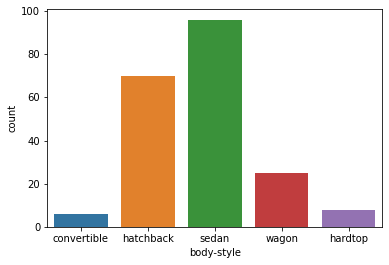

In [45]:
sns.countplot(df['body-style'])

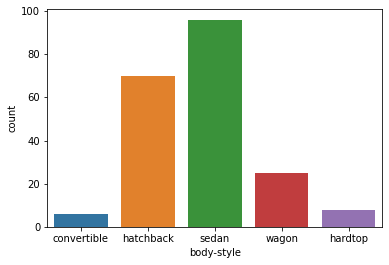

In [46]:
plt.figure(figsize=(6,4))
sns.countplot(df['body-style'])

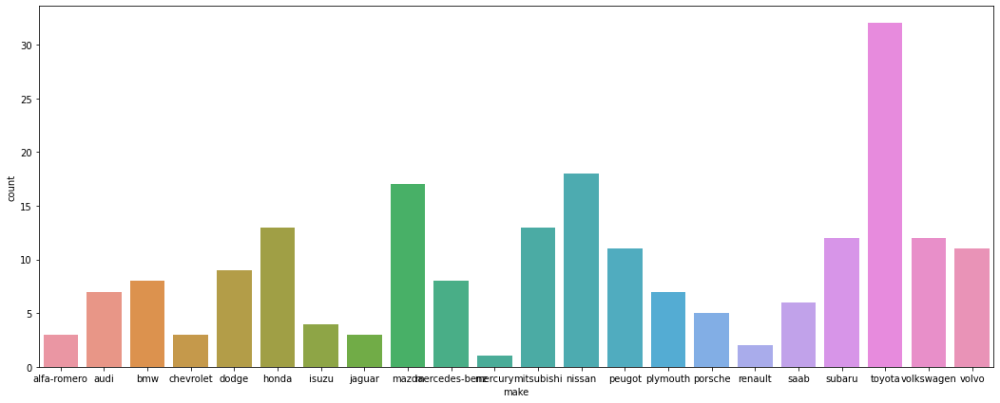

In [47]:
plt.figure(figsize=(18,7))
sns.countplot(df['make'])

<Figure size 1080x720 with 0 Axes>

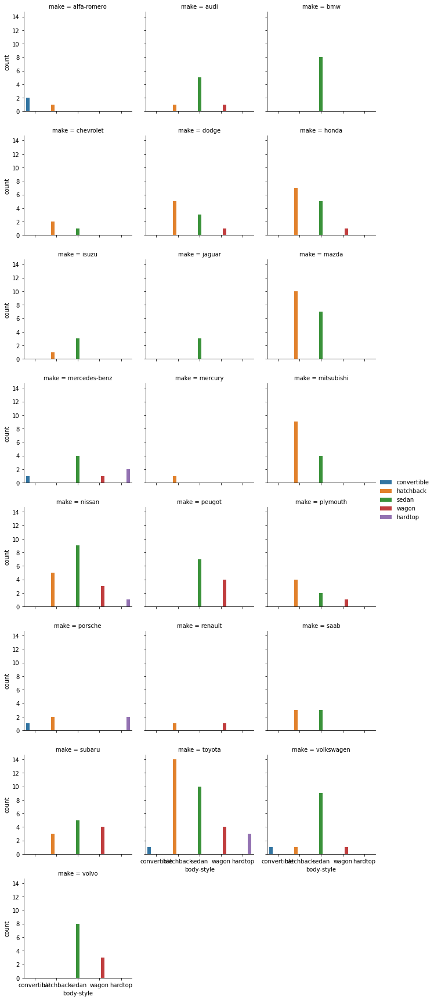

In [36]:
from matplotlib import rcParams
rcParams['figure.figsize'] = 12,8
plt.figure(figsize=(15,10))
sns.catplot(x='body-style', data=df, col='make', hue='body-style', kind='count', col_wrap=3, height=3).add_legend()


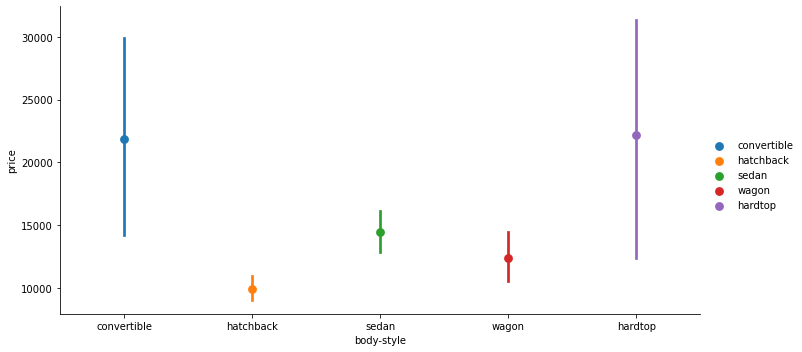

In [93]:
sns.catplot(x='body-style',y='price' ,data=df,  hue='body-style', kind='point', height=5, aspect=2 ).add_legend()


In [98]:
pd.pivot_table(data=df, index='body-style', values='price', aggfunc= {'price':['min','max','mean']})

,max,mean,min
body-style,,,
convertible,37028.0,21890.500000,11595.0
hardtop,45400.0,22208.500000,8249.0
hatchback,22018.0,9949.285714,5118.0
sedan,41315.0,14453.468750,5499.0
wagon,28248.0,12371.960000,6918.0


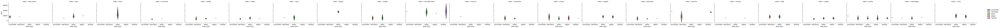

In [83]:
sns.catplot(x='body-style',y='price' ,data=df, col='make' , hue='body-style', kind='violin', height=3, aspect=1.5 ).add_legend()


In [100]:
df['drive-wheels'].value_counts()

fwd    120
rwd     76
4wd      9
Name: drive-wheels, dtype: int64

In [115]:
pd.pivot_table(data=df, index=['body-style','drive-wheels'], aggfunc= {'body-style':'count'})

body-style
body-style  drive-wheels            
convertible fwd                    1
            rwd                    5
hardtop     fwd                    1
            rwd                    7
hatchback   4wd                    2
            fwd                   49
            rwd                   19
sedan       4wd                    3
            fwd                   57
            rwd                   36
wagon       4wd                    4
            fwd                   12
            rwd                    9

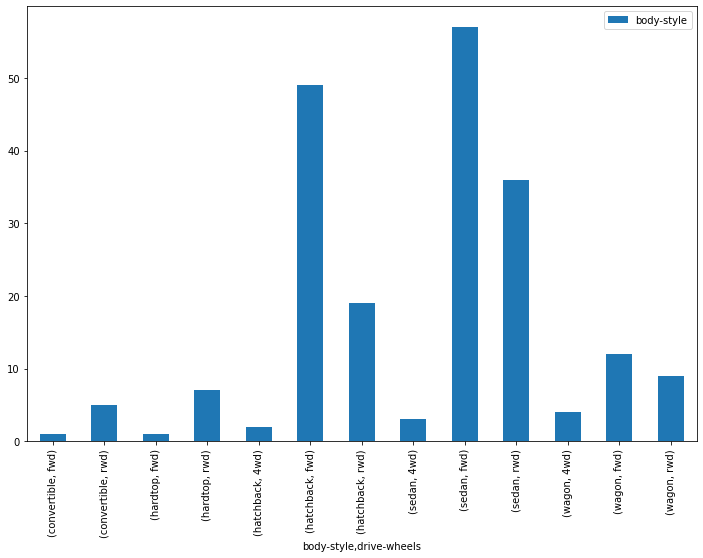

In [118]:
pd.pivot_table(data=df, index=['body-style','drive-wheels'], aggfunc= {'body-style':'count'}).plot.bar(stacked=True)

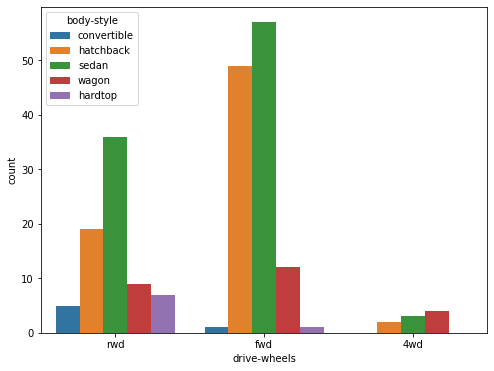

In [122]:
plt.figure(figsize=(8,6))
sns.countplot(df['drive-wheels'], hue='body-style', data=df)

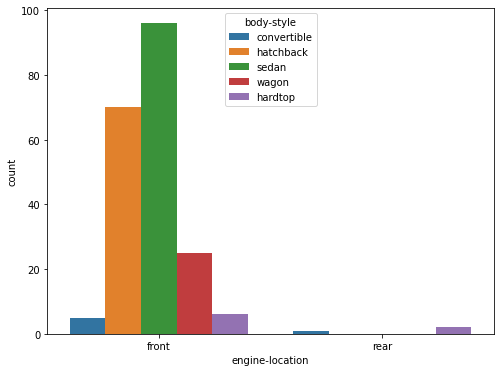

In [124]:
plt.figure(figsize=(8,6))
sns.countplot(df['engine-location'], hue='body-style', data=df)

In [ ]:
### Most cars(low price sedan, hatchback, wagon) are forward wheels
### Most cars (high price ) are reversed wheels.
### 98% cars have engine on front.
### Four dours cars have slighlty higher price average(approx.800$ )
### All cars (high price ) are two doors.
### Most of hatchback are two doors and also higher avg price.
### Even though we can say that only 3 cars have rear engine , but all the three are good cars of porche with high price.

In [123]:
df.head(3)

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,...,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
0,3,46,alfa-romero,gas,std,two,convertible,rwd,front,88.6,...,130,mpfi,3.47,2.68,9.0,111,5000,21,27,13495
1,3,46,alfa-romero,gas,std,two,convertible,rwd,front,88.6,...,130,mpfi,3.47,2.68,9.0,111,5000,21,27,16500
2,1,113,alfa-romero,gas,std,two,hatchback,rwd,front,94.5,...,152,mpfi,2.68,3.47,9.0,154,5000,19,26,16500


In [ ]:
### Even though we know that convertalbe and harddrop have highest prices and also because of thier drive wheels are 'rwd',
### also sedan , hatchback and wagons that are 'rwd' are expensize than other models.
### if a car is 'rwd' and 2-door then it's price is even more than '4-door' 'rwd' cars . And for your information the highest price
### are all also 2-doors. So 2-doors win the race in the case of 'rwd' and 'fwd' also.

In [38]:
ddd = pd.pivot_table(data=df , index=['drive-wheels','body-style'], values='price', aggfunc=[np.mean,'count'])
ddd

mean count
                                 price price
drive-wheels body-style                     
4wd          hatchback     8637.500000     2
             sedan        12647.333333     3
             wagon         9095.750000     4
fwd          convertible  11595.000000     1
             hardtop       8249.000000     1
             hatchback     8396.387755    49
             sedan         9964.298246    57
             wagon         9997.333333    12
rwd          convertible  23949.600000     5
             hardtop      24202.714286     7
             hatchback    14092.210526    19
             sedan        21711.833333    36
             wagon        16994.222222     9

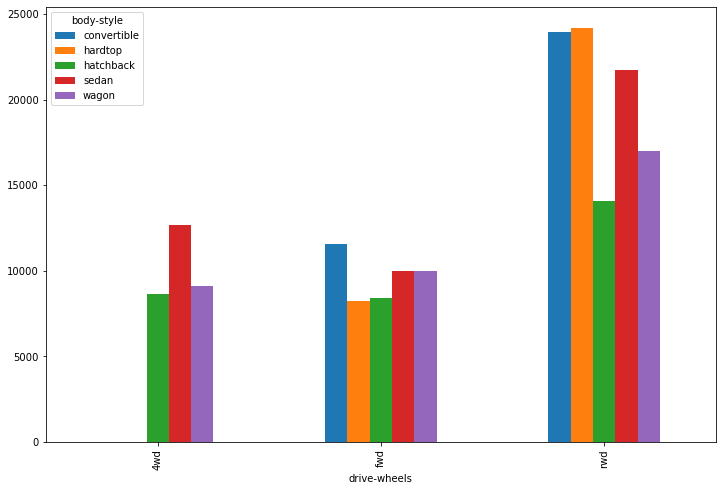

In [57]:
#ddd#.reset_index(inplace=True)
s = pd.pivot(data=ddd , index='drive-wheels', columns='body-style', values= ( 'mean', 'price'))
s.plot.bar()

In [43]:
ddd.columns

MultiIndex([( 'mean', 'price'),
            ('count', 'price')],
           )

In [59]:
df['num-of-doors'].value_counts()

four    116
two      89
Name: num-of-doors, dtype: int64

In [58]:
#df['num-of-doors'].value_counts()
pd.pivot_table(data=df , index=['num-of-doors','drive-wheels','body-style'], values='price', aggfunc=[np.mean,'count'])

mean count
                                              price price
num-of-doors drive-wheels body-style                     
four         4wd          sedan        12647.333333     3
                          wagon         9095.750000     4
             fwd          hatchback     8372.000000    10
                          sedan        10123.250000    48
                          wagon         9997.333333    12
             rwd          sedan        21651.833333    30
                          wagon        16994.222222     9
two          4wd          hatchback     8637.500000     2
             fwd          convertible  11595.000000     1
                          hardtop       8249.000000     1
                          hatchback     8402.641026    39
                          sedan         9116.555556     9
             rwd          convertible  23949.600000     5
                          hardtop      24202.714286     7
                          hatchback    14092.210526    19
                          sedan        22011.833333     6

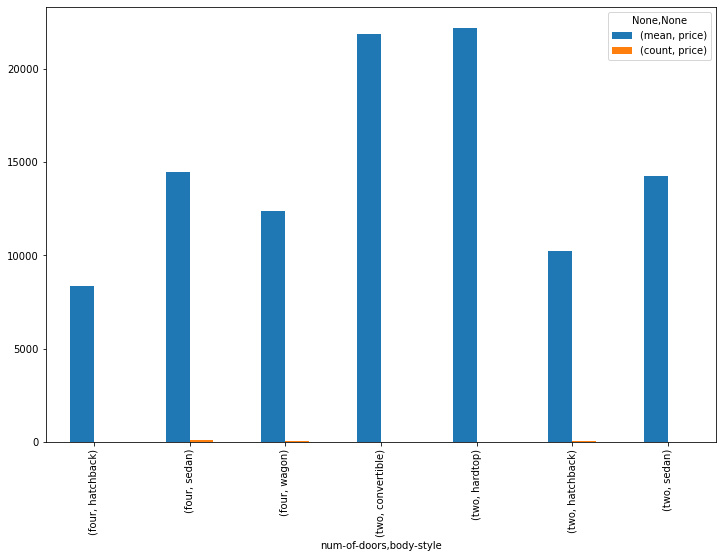

In [155]:
rcParams['figure.figsize'] == 8,6
pd.pivot_table(data=df , index=['num-of-doors','body-style'], values='price', aggfunc=[np.mean,'count']).plot.bar()

In [147]:
#df[(df['num-of-doors'] == 'four') & (df['body-style'].isin(['sedan','hatchback','wagon']))]

In [156]:
df['engine-location'].value_counts()

front    202
rear       3
Name: engine-location, dtype: int64

In [157]:
df[df['engine-location'] == 'rear']

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,...,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
126,3,82,porsche,gas,std,two,hardtop,rwd,rear,89.5,...,194,mpfi,3.74,2.9,9.5,207,5900,17,25,32528
127,3,82,porsche,gas,std,two,hardtop,rwd,rear,89.5,...,194,mpfi,3.74,2.9,9.5,207,5900,17,25,34028
128,3,46,porsche,gas,std,two,convertible,rwd,rear,89.5,...,194,mpfi,3.74,2.9,9.5,207,5900,17,25,37028


In [158]:
df['fuel-type'].value_counts()

gas       185
diesel     20
Name: fuel-type, dtype: int64

In [159]:
df[df['fuel-type'] == 'diesel']

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,...,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
63,0,100,mazda,diesel,std,four,sedan,fwd,front,98.8,...,122,idi,3.39,3.39,22.7,64,4650,36,42,10795
66,0,100,mazda,diesel,std,four,sedan,rwd,front,104.9,...,134,idi,3.43,3.64,22.0,72,4200,31,39,18344
67,-1,93,mercedes-benz,diesel,turbo,four,sedan,rwd,front,110.0,...,183,idi,3.58,3.64,21.5,123,4350,22,25,25552
68,-1,93,mercedes-benz,diesel,turbo,four,wagon,rwd,front,110.0,...,183,idi,3.58,3.64,21.5,123,4350,22,25,28248
69,0,93,mercedes-benz,diesel,turbo,two,hardtop,rwd,front,106.7,...,183,idi,3.58,3.64,21.5,123,4350,22,25,28176
70,-1,93,mercedes-benz,diesel,turbo,four,sedan,rwd,front,115.6,...,183,idi,3.58,3.64,21.5,123,4350,22,25,31600
90,1,128,nissan,diesel,std,two,sedan,fwd,front,94.5,...,103,idi,2.99,3.47,21.9,55,4800,45,50,7099
108,0,161,peugot,diesel,turbo,four,sedan,rwd,front,107.9,...,152,idi,3.70,3.52,21.0,95,4150,28,33,13200
110,0,59,peugot,diesel,turbo,four,wagon,rwd,front,114.2,...,152,idi,3.70,3.52,21.0,95,4150,25,25,13860
112,0,161,peugot,diesel,turbo,four,sedan,rwd,front,107.9,...,152,idi,3.70,3.52,21.0,95,4150,28,33,16900


In [160]:
df[df['body-style'].isin(['hardtop','convertible'])]

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,...,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
0,3,46,alfa-romero,gas,std,two,convertible,rwd,front,88.6,...,130,mpfi,3.47,2.68,9.0,111,5000,21,27,13495
1,3,46,alfa-romero,gas,std,two,convertible,rwd,front,88.6,...,130,mpfi,3.47,2.68,9.0,111,5000,21,27,16500
69,0,93,mercedes-benz,diesel,turbo,two,hardtop,rwd,front,106.7,...,183,idi,3.58,3.64,21.5,123,4350,22,25,28176
72,3,142,mercedes-benz,gas,std,two,convertible,rwd,front,96.6,...,234,mpfi,3.46,3.10,8.3,155,4750,16,18,35056
74,1,82,mercedes-benz,gas,std,two,hardtop,rwd,front,112.0,...,304,mpfi,3.80,3.35,8.0,184,4500,14,16,45400
98,2,168,nissan,gas,std,two,hardtop,fwd,front,95.1,...,97,2bbl,3.15,3.29,9.4,69,5200,31,37,8249
126,3,82,porsche,gas,std,two,hardtop,rwd,rear,89.5,...,194,mpfi,3.74,2.90,9.5,207,5900,17,25,32528
127,3,82,porsche,gas,std,two,hardtop,rwd,rear,89.5,...,194,mpfi,3.74,2.90,9.5,207,5900,17,25,34028
128,3,46,porsche,gas,std,two,convertible,rwd,rear,89.5,...,194,mpfi,3.74,2.90,9.5,207,5900,17,25,37028
167,2,134,toyota,gas,std,two,hardtop,rwd,front,98.4,...,146,mpfi,3.62,3.50,9.3,116,4800,24,30,8449


### engine-size, fuel-system, stroke, horsepower, peak-rpm,wheel-base.

In [62]:
df.head()

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,...,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
0,3,46,alfa-romero,gas,std,two,convertible,rwd,front,88.6,...,130,mpfi,3.47,2.68,9.0,111,5000,21,27,13495
1,3,46,alfa-romero,gas,std,two,convertible,rwd,front,88.6,...,130,mpfi,3.47,2.68,9.0,111,5000,21,27,16500
2,1,113,alfa-romero,gas,std,two,hatchback,rwd,front,94.5,...,152,mpfi,2.68,3.47,9.0,154,5000,19,26,16500
3,2,164,audi,gas,std,four,sedan,fwd,front,99.8,...,109,mpfi,3.19,3.40,10.0,102,5500,24,30,13950
4,2,164,audi,gas,std,four,sedan,4wd,front,99.4,...,136,mpfi,3.19,3.40,8.0,115,5500,18,22,17450


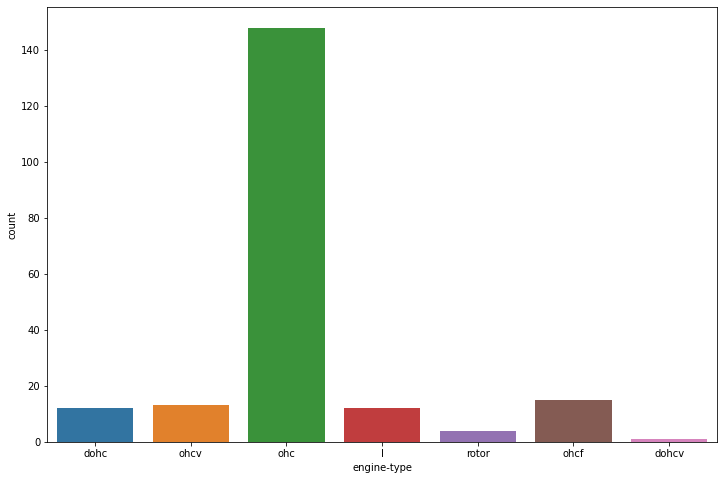

In [64]:
sns.countplot(df['engine-type'])

In [48]:
aaa = pd.pivot_table(data=df, index=['engine-type','drive-wheels'], values='price', aggfunc={np.mean,'count'})
aaa

count          mean
engine-type drive-wheels                     
dohc        fwd             2.0  18385.000000
            rwd            10.0  18062.700000
dohcv       rwd             1.0   9672.000000
l           fwd             1.0   5151.000000
            rwd            11.0  15489.090909
ohc         4wd             4.0  10949.500000
            fwd           107.0   9169.990654
            rwd            37.0  18655.891892
ohcf        4wd             5.0   9560.400000
            fwd             7.0   7813.285714
            rwd             3.0  34528.000000
ohcv        fwd             3.0  13799.000000
            rwd            10.0  28488.200000
rotor       rwd             4.0  13020.000000

In [50]:
aaa#.reset_index(inplace=True)
#aaa.drop(['count'], axis=1)
#sns.barplot(x=aaa['engine-type'], hue=aaa['drive-wheels'])
bb = pd.pivot(data=aaa, index='engine-type', columns='drive-wheels', values='mean')
plt.figure(figsize=(7,5))
bb.style.background_gradient(cmap='coolwarm')

drive-wheels,4wd,fwd,rwd
engine-type,,,
dohc,nan,18385.000000,18062.700000
dohcv,nan,nan,9672.000000
l,nan,5151.000000,15489.090909
ohc,10949.500000,9169.990654,18655.891892
ohcf,9560.400000,7813.285714,34528.000000
ohcv,nan,13799.000000,28488.200000
rotor,nan,nan,13020.000000


<Figure size 504x360 with 0 Axes>

In [51]:
aaa = pd.pivot_table(data=df, index=['engine-type','body-style'], values='price', aggfunc={np.mean,'count'})
aaa

count          mean
engine-type body-style                      
dohc        convertible    2.0  14997.500000
            hatchback      4.0  15061.000000
            sedan          5.0  22281.600000
            wagon          1.0  15750.000000
dohcv       hatchback      1.0   9672.000000
l           hatchback      1.0   5151.000000
            sedan          7.0  15758.571429
            wagon          4.0  15017.500000
ohc         convertible    2.0  14632.000000
            hardtop        5.0  13142.400000
            hatchback     53.0   9013.811321
            sedan         73.0  13162.123288
            wagon         15.0  12114.133333
ohcf        convertible    1.0  37028.000000
            hardtop        2.0  33278.000000
            hatchback      3.0   6591.333333
            sedan          5.0   9070.600000
            wagon          4.0   9342.000000
ohcv        convertible    1.0  35056.000000
            hardtop        1.0  45400.000000
            hatchback      4.0  17949.250000
            sedan          6.0  26604.500000
            wagon          1.0  14399.000000
rotor       hatchback      4.0  13020.000000

In [ ]:
### ohcv engine is very good for approx. all cars , they all have high prices.

In [53]:
aaa#.reset_index(inplace=True)
bb = pd.pivot(data=aaa, index='engine-type', columns='body-style', values='mean')
plt.figure(figsize=(7,5))
bb.style.background_gradient(cmap='coolwarm')

body-style,convertible,hardtop,hatchback,sedan,wagon
engine-type,,,,,
dohc,14997.500000,nan,15061.000000,22281.600000,15750.000000
dohcv,nan,nan,9672.000000,nan,nan
l,nan,nan,5151.000000,15758.571429,15017.500000
ohc,14632.000000,13142.400000,9013.811321,13162.123288,12114.133333
ohcf,37028.000000,33278.000000,6591.333333,9070.600000,9342.000000
ohcv,35056.000000,45400.000000,17949.250000,26604.500000,14399.000000
rotor,nan,nan,13020.000000,nan,nan


<Figure size 504x360 with 0 Axes>

In [66]:
df['price'].describe()

count      205.000000
mean     13181.917073
std       7877.071768
min       5118.000000
25%       7788.000000
50%      10295.000000
75%      16500.000000
max      45400.000000
Name: price, dtype: float64

1.8303707622829615
3.3515238137921064


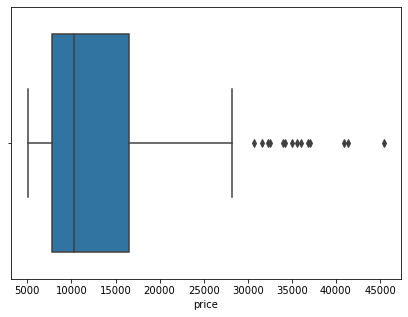

In [71]:
plt.figure(figsize=(7,5))
sns.boxplot(df['price'])
print(df['price'].skew())
print(df['price'].kurtosis())

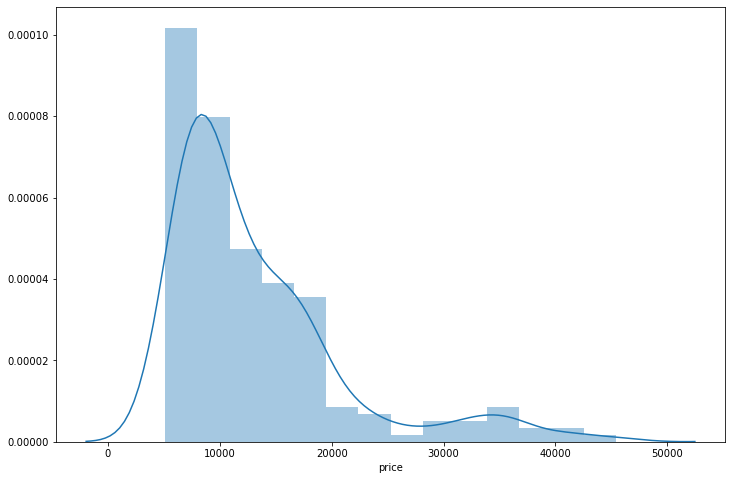

In [72]:
sns.distplot(df['price'])

In [100]:
exp = df[(df['price'] > 20000)]
exp['horsepower'].mean()

158.04

In [60]:
df.head(3)

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,...,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
0,3,46,alfa-romero,gas,std,two,convertible,rwd,front,88.6,...,130,mpfi,3.47,2.68,9.0,111,5000,21,27,13495
1,3,46,alfa-romero,gas,std,two,convertible,rwd,front,88.6,...,130,mpfi,3.47,2.68,9.0,111,5000,21,27,16500
2,1,113,alfa-romero,gas,std,two,hatchback,rwd,front,94.5,...,152,mpfi,2.68,3.47,9.0,154,5000,19,26,16500


In [71]:
df['fuel-system'].value_counts()

mpfi    94
2bbl    66
idi     20
1bbl    11
spdi     9
4bbl     3
spfi     1
mfi      1
Name: fuel-system, dtype: int64

In [79]:
xx = pd.pivot_table(data=df, index=['fuel-system','body-style'], aggfunc={'body-style':'count','price':'mean'})
xx


body-style         price
fuel-system body-style                           
1bbl        hatchback             7   7054.428571
            sedan                 3   8811.666667
            wagon                 1   7295.000000
2bbl        hardtop               1   8249.000000
            hatchback            28   6979.678571
            sedan                28   8146.464286
            wagon                 9   8028.888889
4bbl        hatchback             3  12145.000000
idi         hardtop               1  28176.000000
            hatchback             1   7788.000000
            sedan                15  14774.400000
            wagon                 3  19727.666667
mfi         hatchback             1  12964.000000
mpfi        convertible           6  21890.500000
            hardtop               6  23540.500000
            hatchback            22  13774.863636
            sedan                48  18600.479167
            wagon                12  14213.416667
spdi        hatchback             7  11479.428571
            sedan                 2   9279.000000
spfi        hatchback             1  11048.000000

In [80]:
xx = pd.pivot_table(data=df, index=['fuel-system','drive-wheels'], aggfunc={'drive-wheels':'count','price':'mean'})
xx


drive-wheels         price
fuel-system drive-wheels                            
1bbl        fwd                     11   7555.545455
2bbl        4wd                      5   8305.000000
            fwd                     58   7576.465517
            rwd                      3   7693.666667
4bbl        rwd                      3  12145.000000
idi         fwd                      9   9265.333333
            rwd                     11  21215.909091
mfi         fwd                      1  12964.000000
mpfi        4wd                      4  12518.750000
            fwd                     33  12550.060606
            rwd                     57  20610.350877
spdi        fwd                      8  10768.750000
            rwd                      1  12764.000000
spfi        rwd                      1  11048.000000

In [ ]:
### Horse power has good relation with price and , also good relation with 'drive-wheels' also

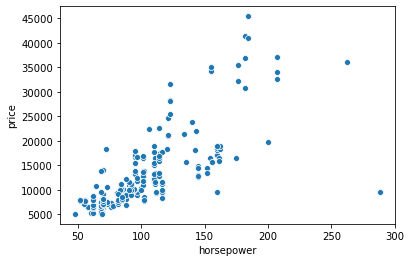

In [84]:
sns.scatterplot(df['horsepower'], df['price'])

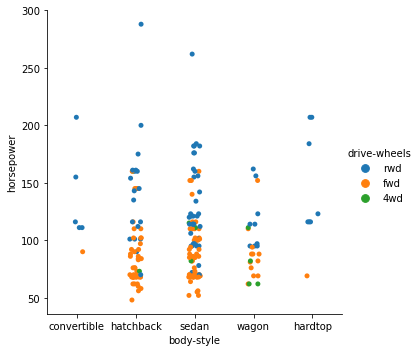

In [95]:
sns.catplot(x='body-style',y='horsepower', data=df, hue='drive-wheels')

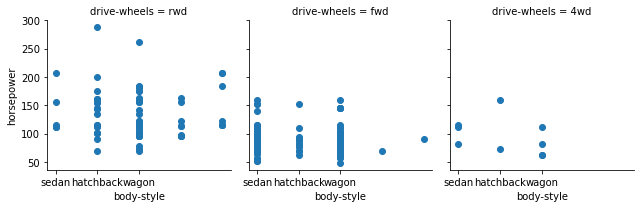

In [93]:
sns.FacetGrid(data=df, col='drive-wheels').map(plt.scatter, 'body-style','horsepower',)

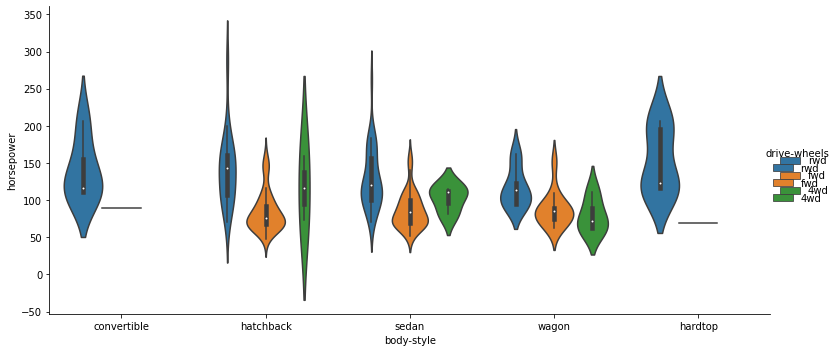

In [94]:
sns.catplot(x='body-style',y='horsepower' ,data=df,  hue='drive-wheels', kind='violin', height=5, aspect=2 ).add_legend()
